Experimental Dataset - 2D class - class 30- 128x128

# Setup

In [52]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
from sklearn import metrics
import numpy as np
import torch
import h5py
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [53]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [54]:
KEYWORD      = 'cryo_exp_class_2d_30_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_30_epoch_100_checkpoint.pth'
EPOCH_NUMBER = 100

In [55]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_30_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [56]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (4917, 1, 128, 128) metadata.shape (4917, 180, 180)


In [57]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_100_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_100_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(4917, 3)

In [58]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_100_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_100_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [59]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

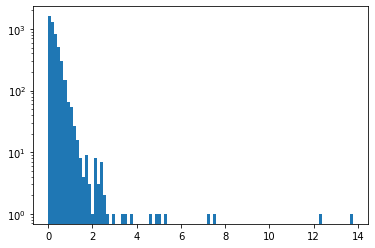

0.3076966410550946 0.4419991678740162


In [60]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

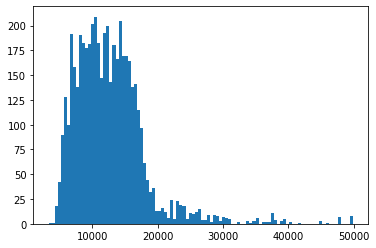

3333.739502 12692.950592391499 5603.567648669399


In [61]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

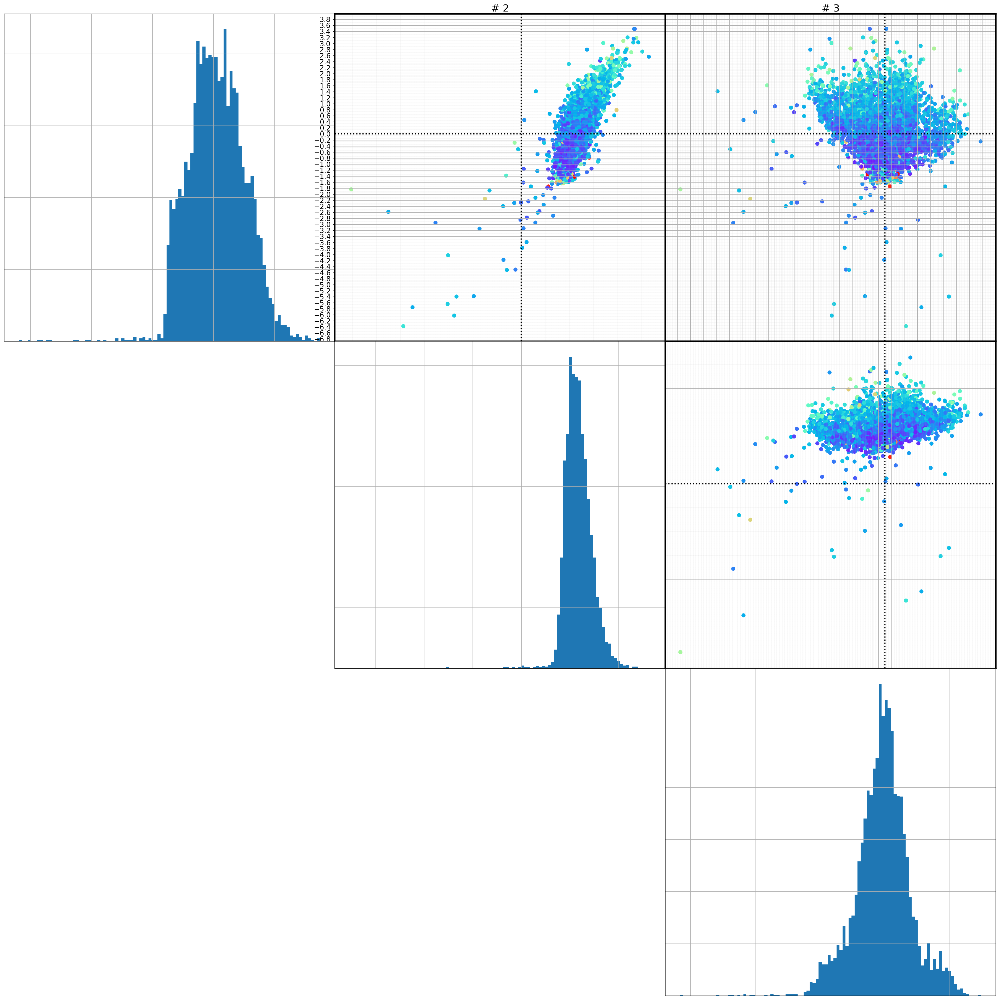

In [62]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [95]:
U, L, Vt = np.linalg.svd(mus - np.mean(mus,axis=0), full_matrices=False)

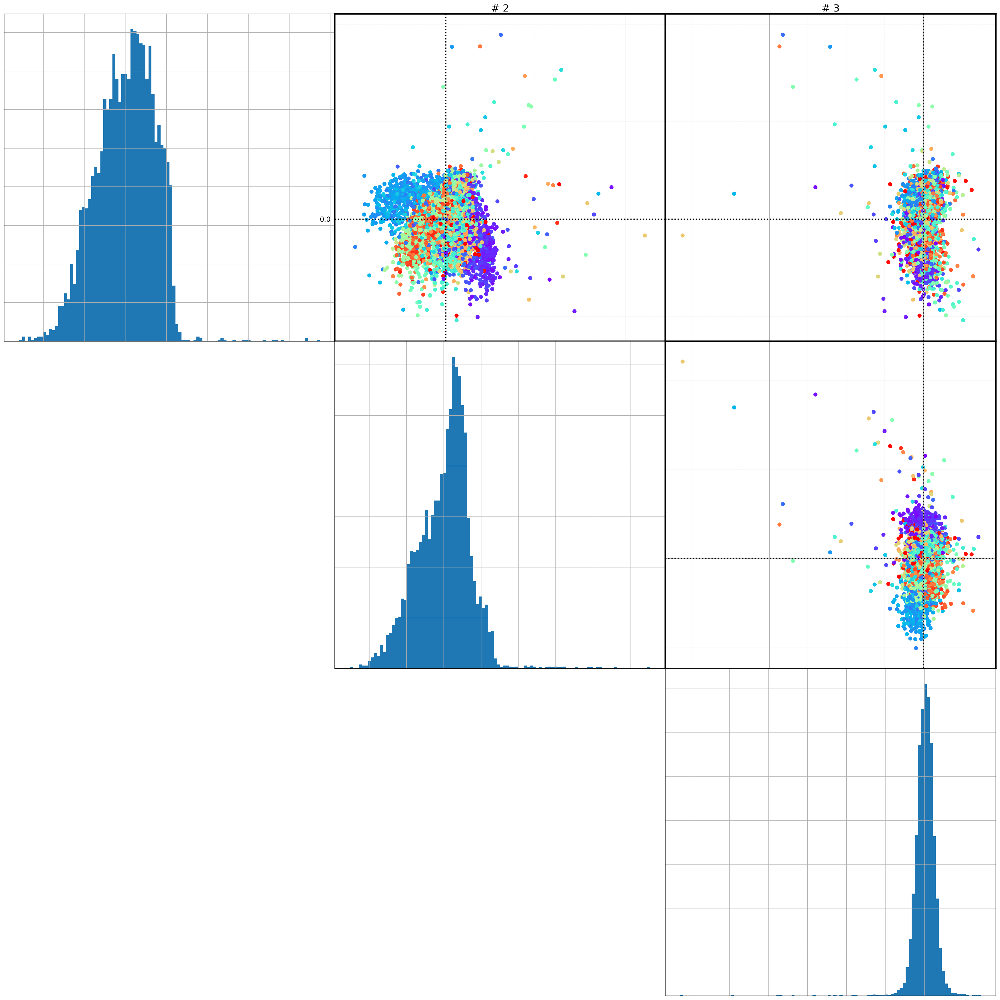

In [96]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlnanglepsi'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

In [97]:
Zscore_set=2

In [98]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(4883,) (34,)


AUC(robust_covar) = 0.8978508872318127
AUC(isolation_forest) = 0.8889906157015335
AUC(local_outlier_detection) = 0.8323836599968679


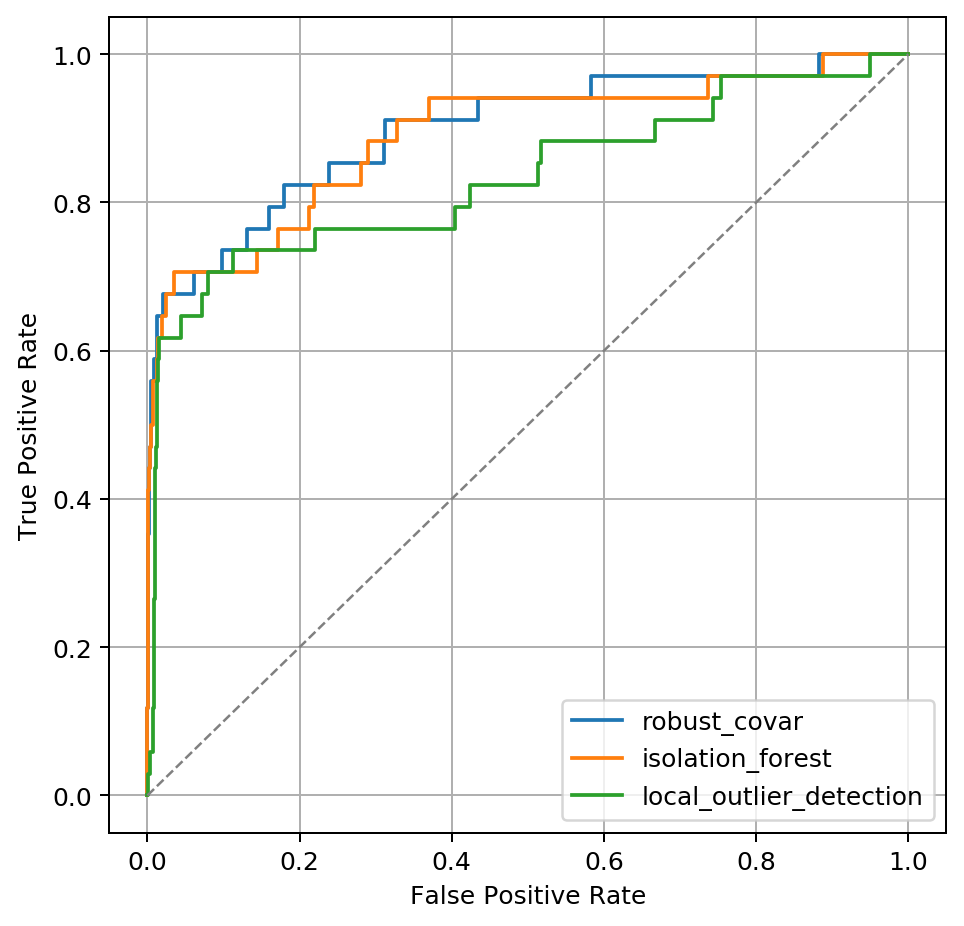

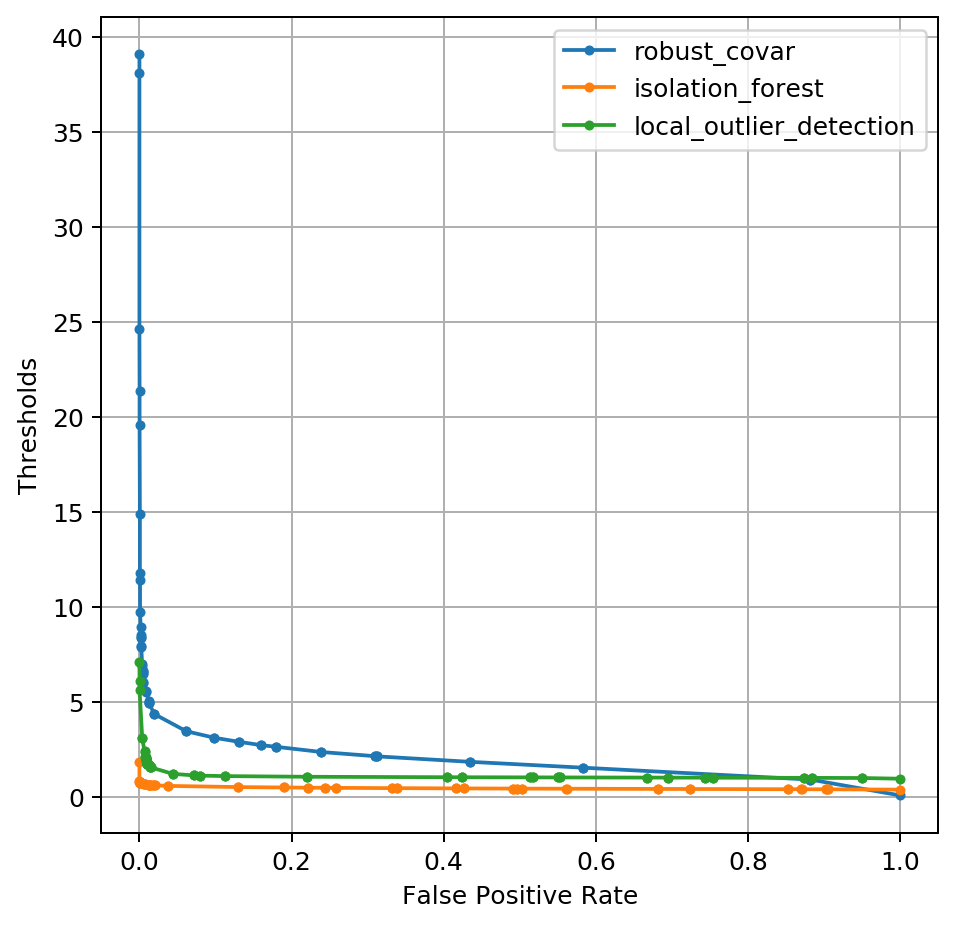

In [99]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [100]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

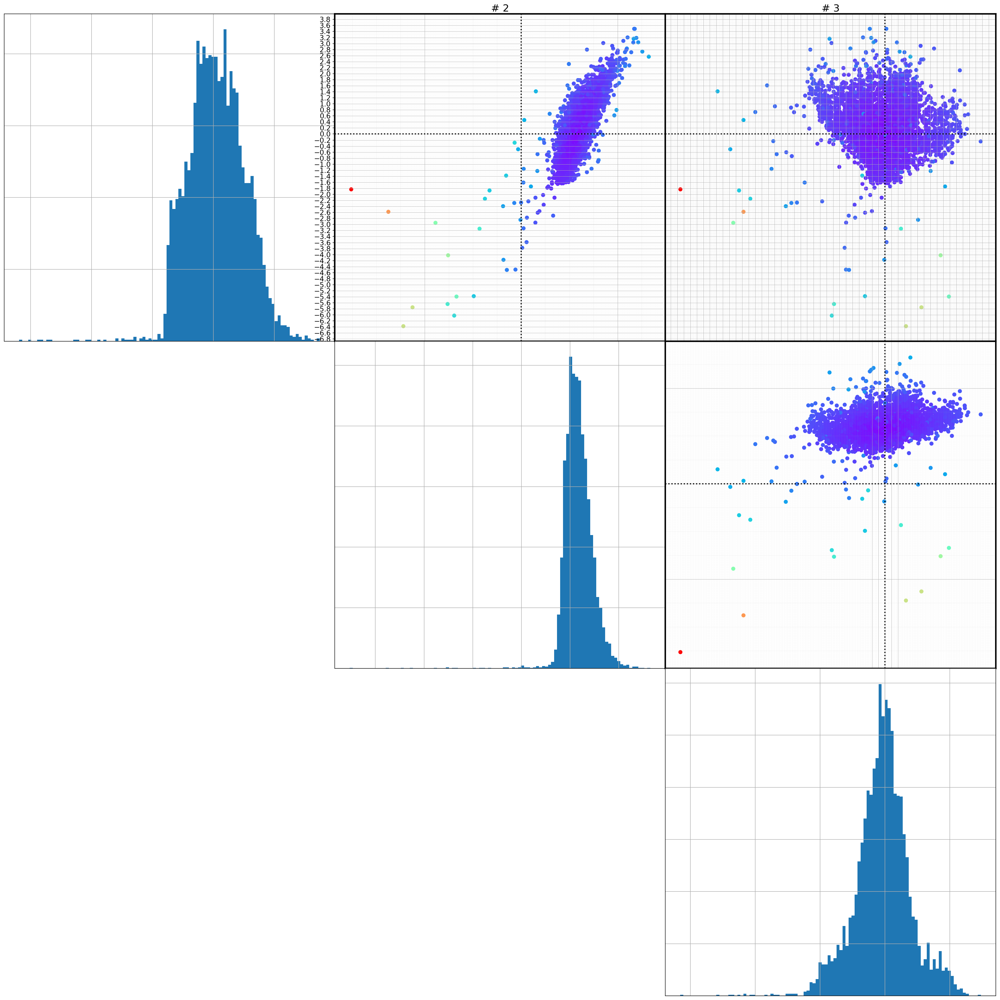

In [69]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [101]:
measure_threshold=3

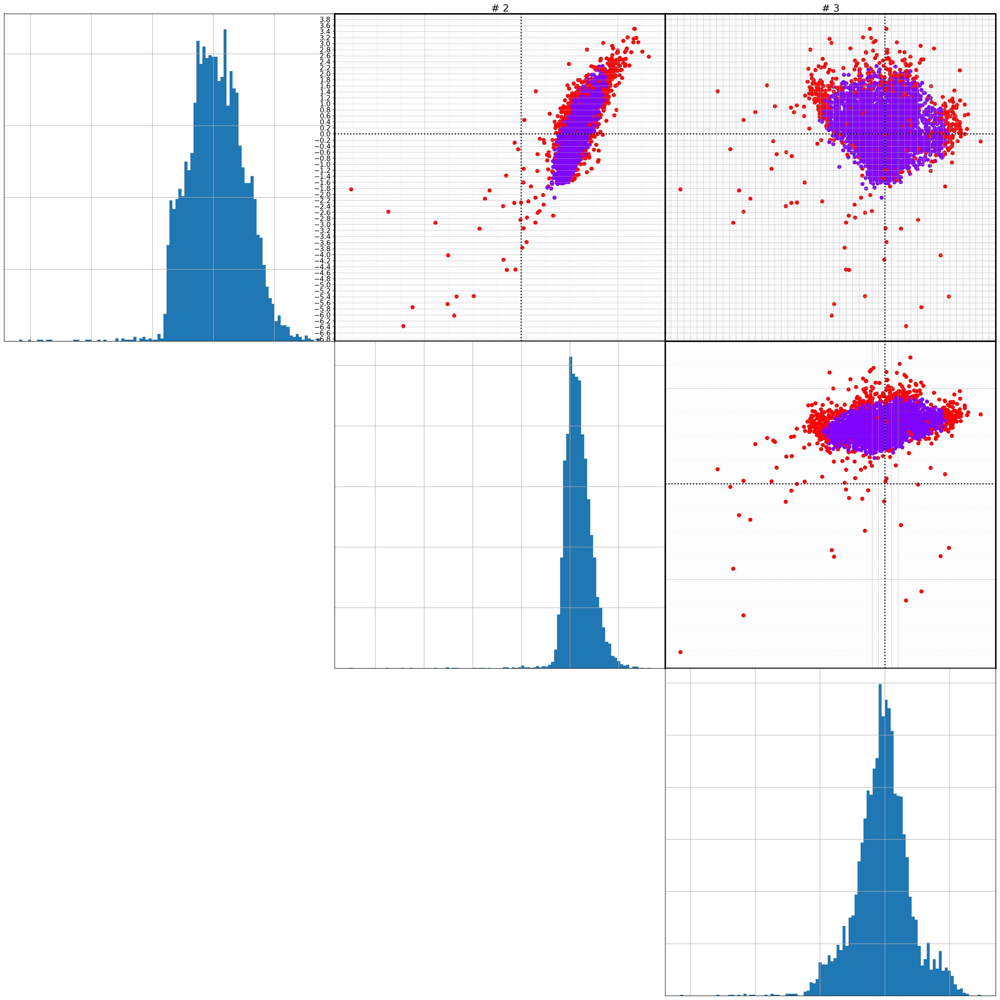

In [102]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [103]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4354, 3)
(4354,)
(4354,)
(4354,)


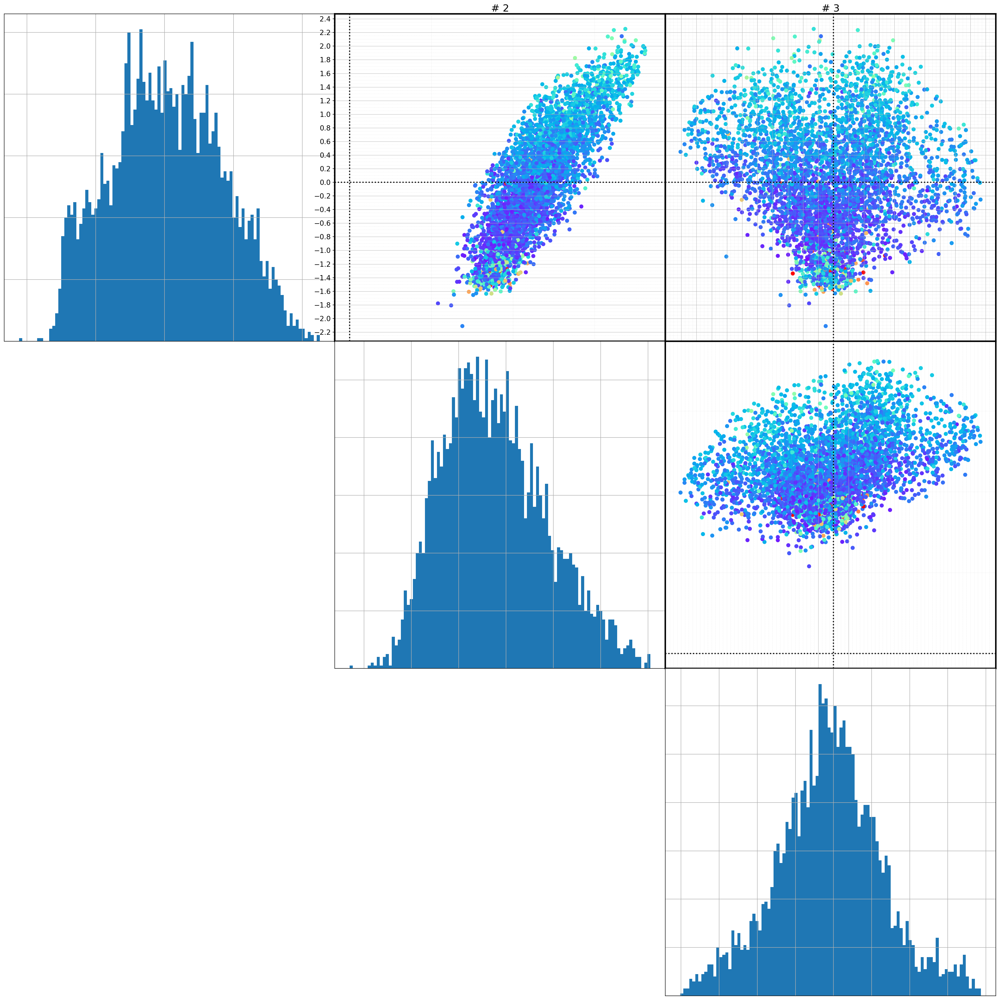

In [104]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [105]:
U, L, Vt = np.linalg.svd(mus_kept - np.mean(mus_kept,axis=0), full_matrices=False)

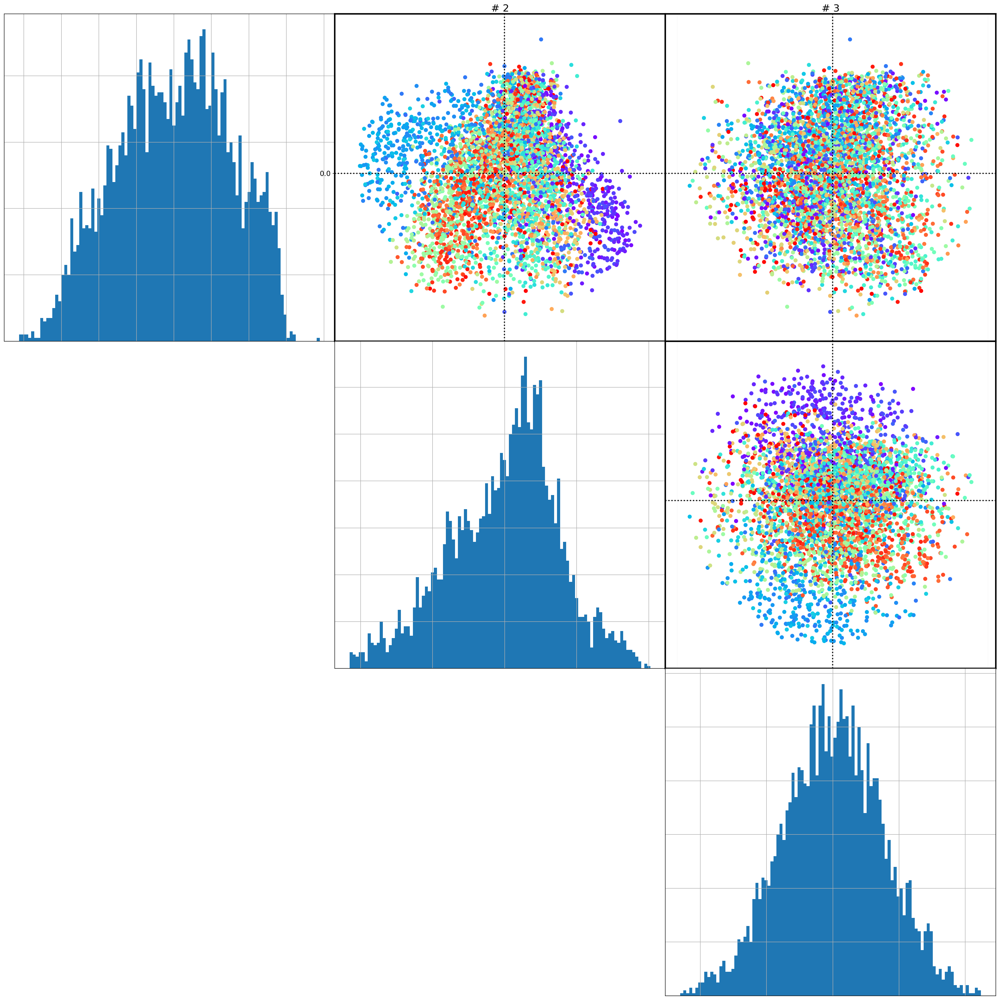

In [106]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

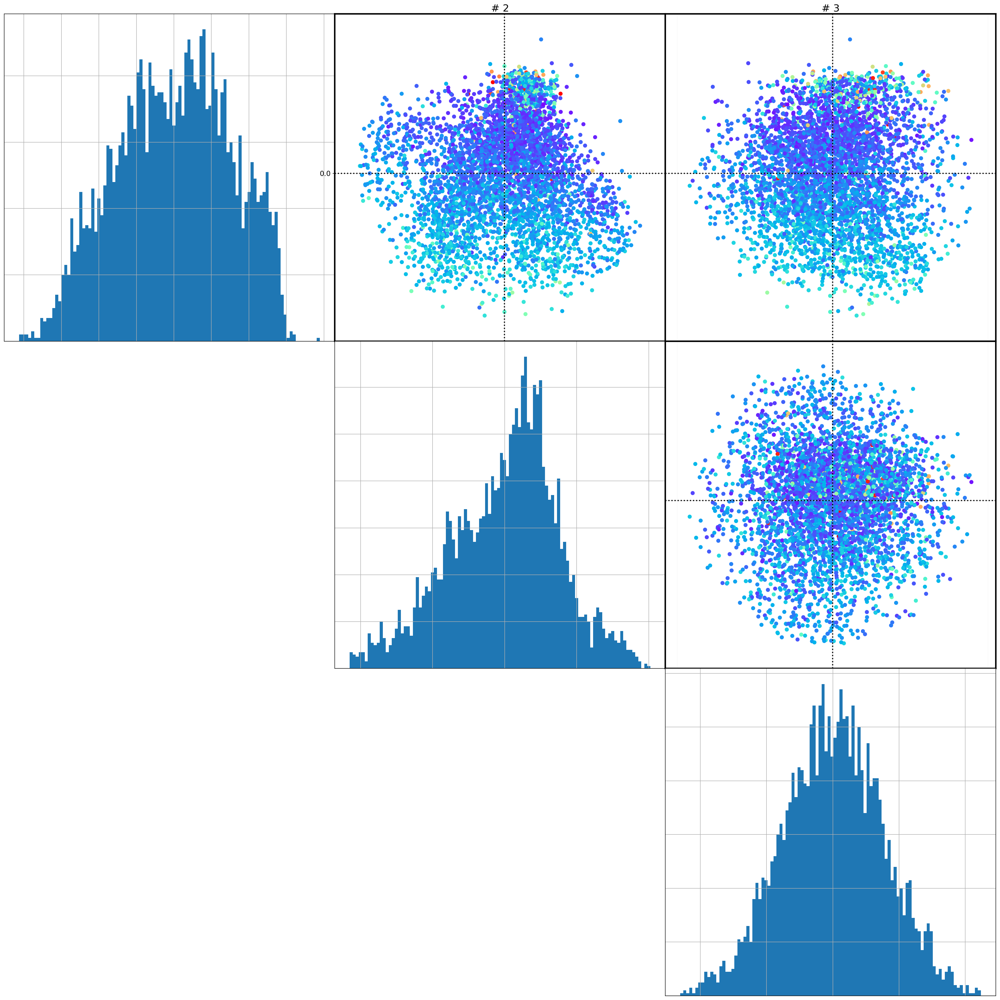

In [107]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [108]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [109]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

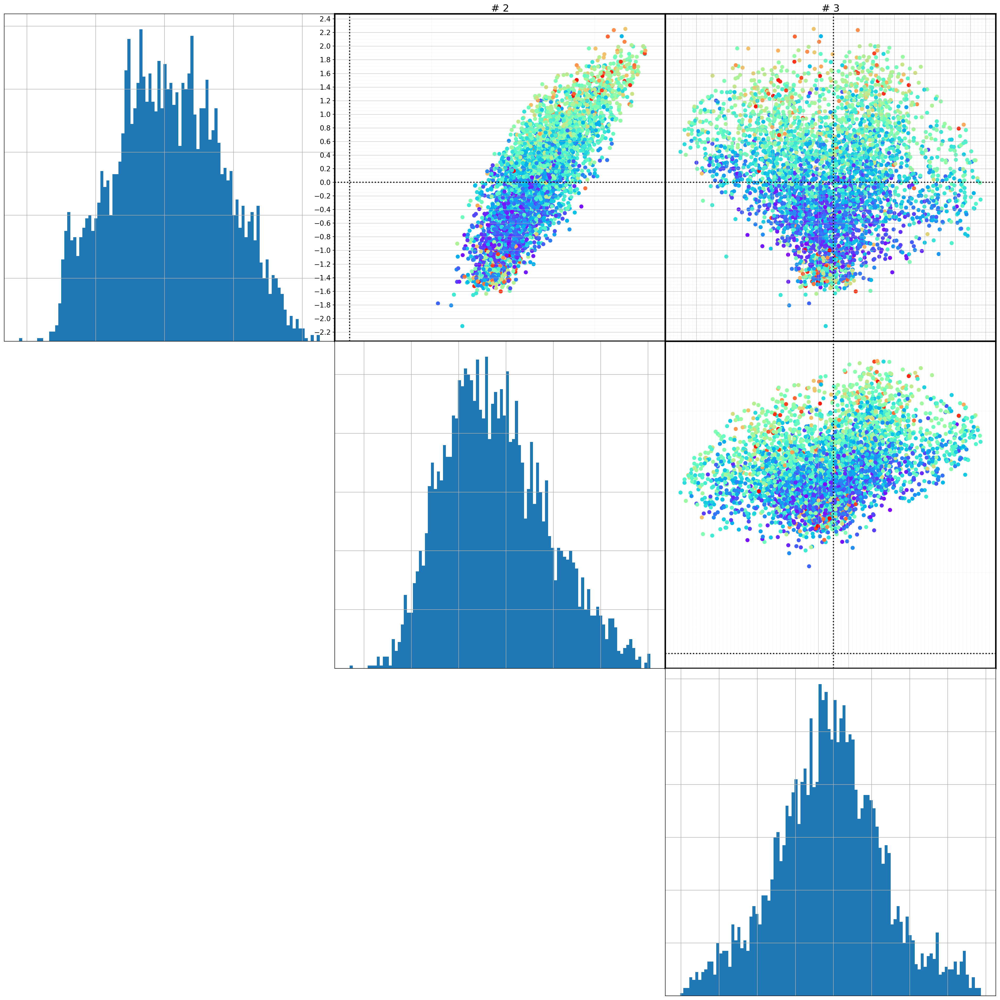

In [110]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [111]:
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:]-np.mean(mus_kept[index,:],axis=0), full_matrices=False)

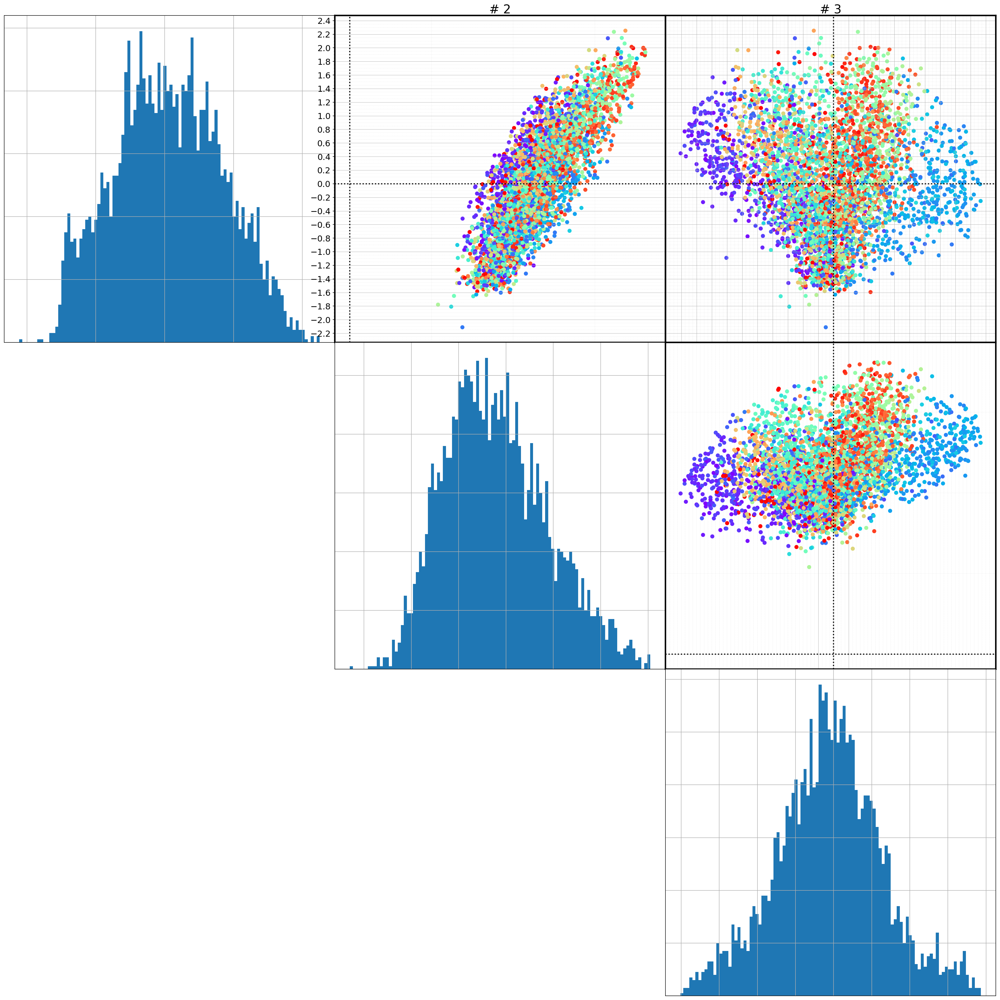

In [122]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

In [123]:
from sklearn.decomposition import FastICA
ica = FastICA(n_components=3)
S_ = ica.fit_transform(mus_kept[index,:])  # Reconstruct signals
A_ = ica.mixing_  # Get estimated mixing matrix
print(S_.shape, A_.shape)

(4184, 3) (3, 3)


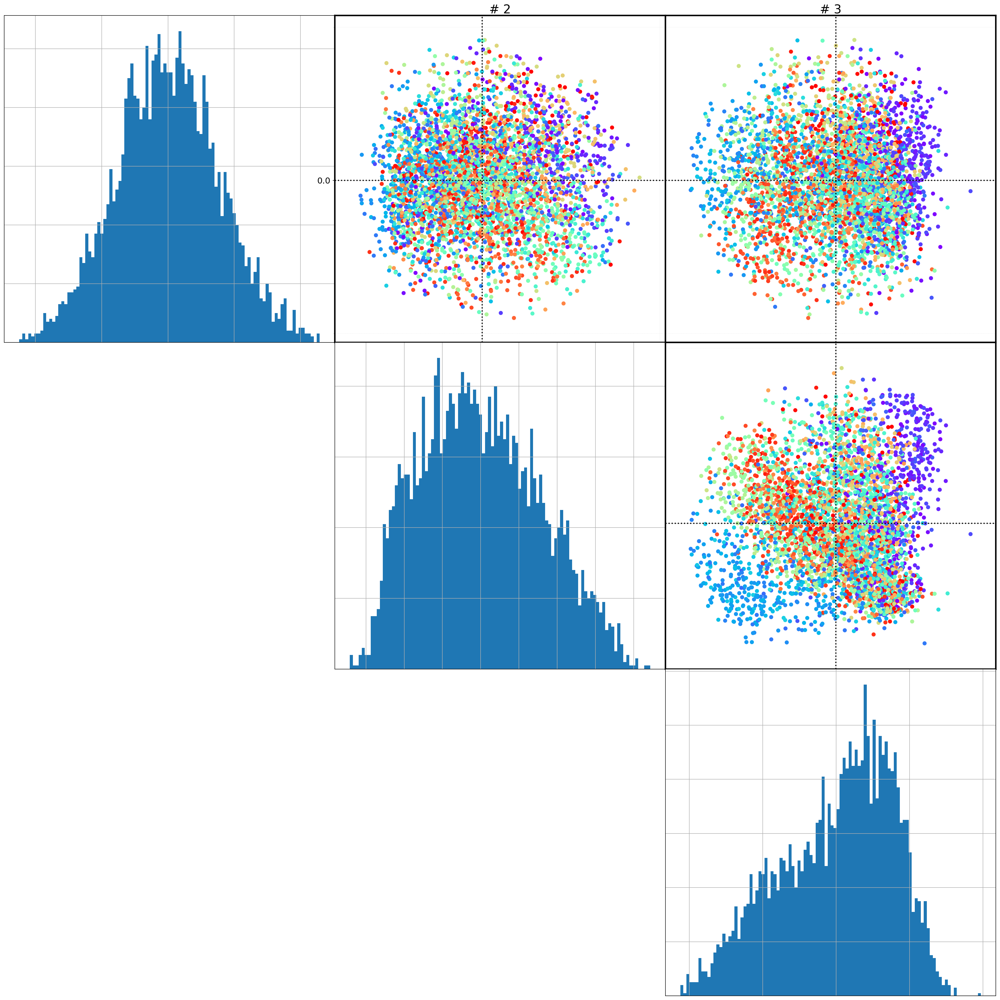

In [124]:
viz.biplots(S_, n=3, show_histo=True, nbins=100, c=angle_kept[index])

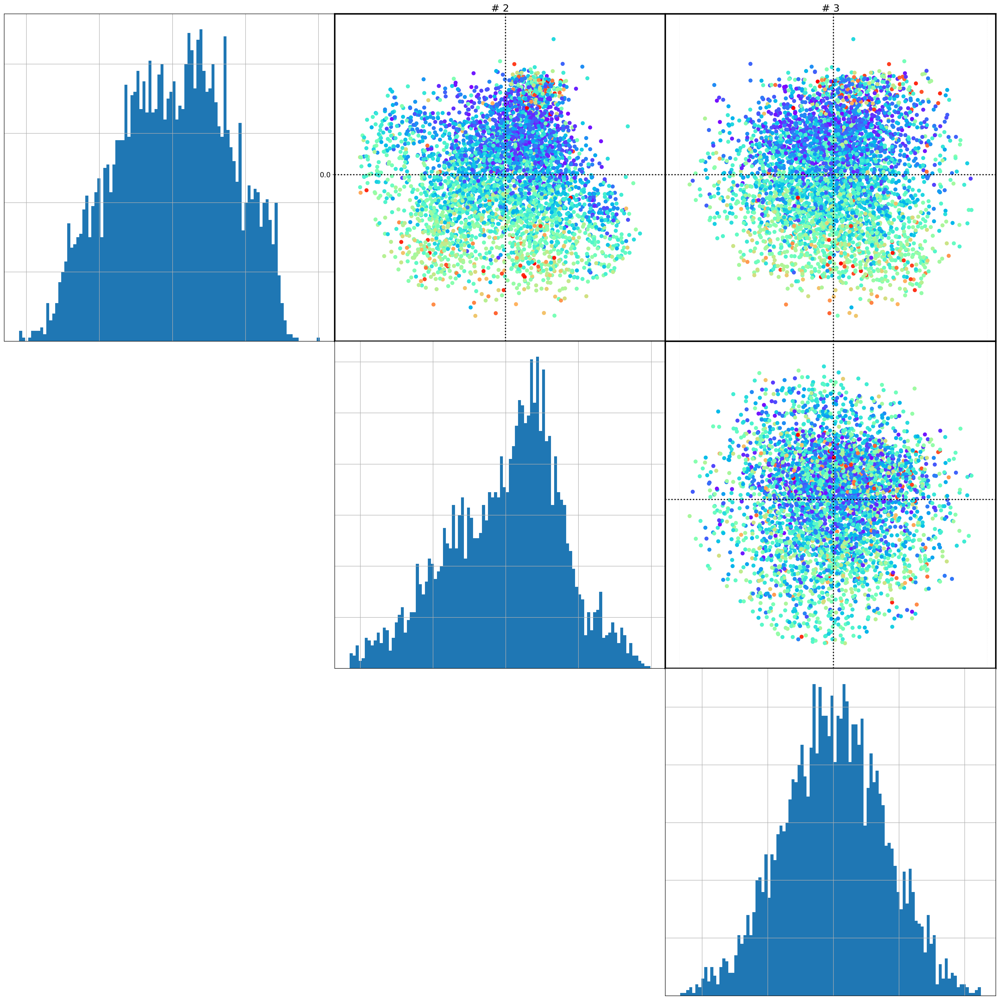

In [113]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

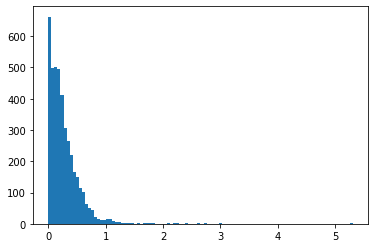

In [114]:
plt.hist(Zscore_kept[index], bins=100)
plt.show()

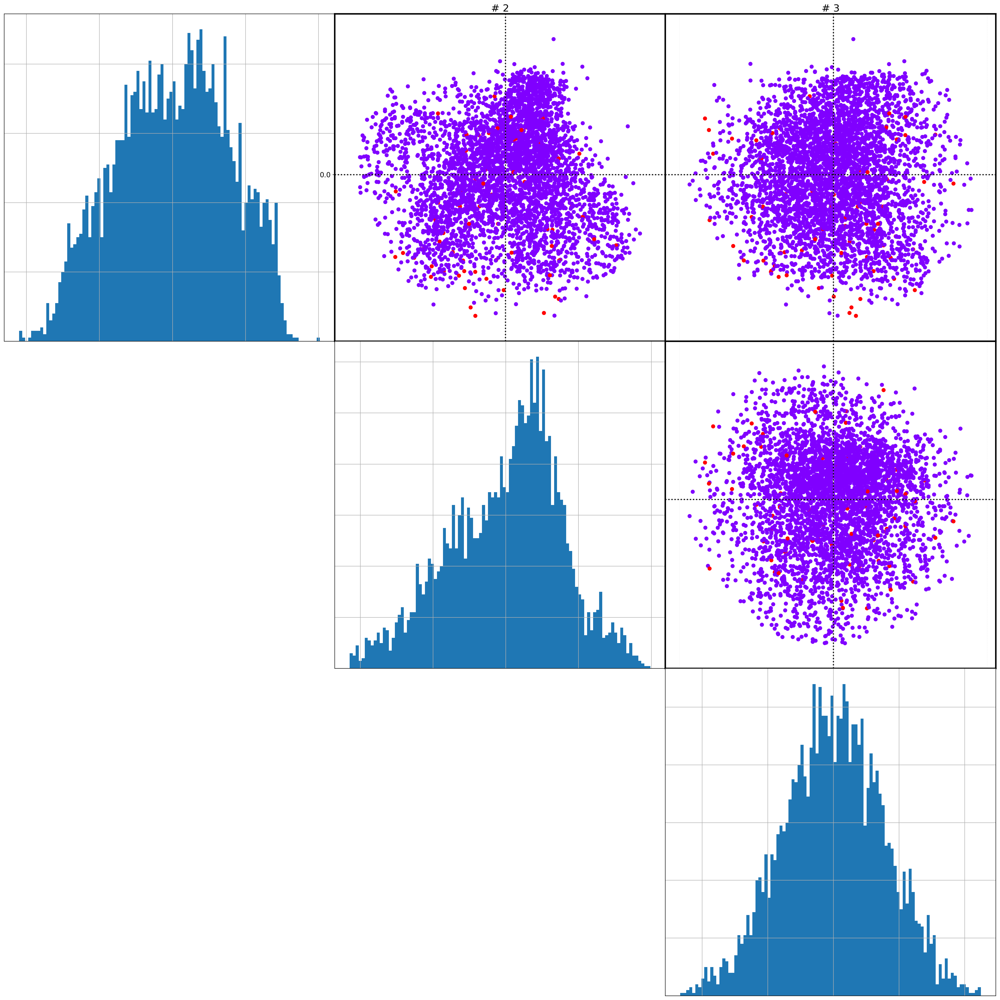

In [115]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

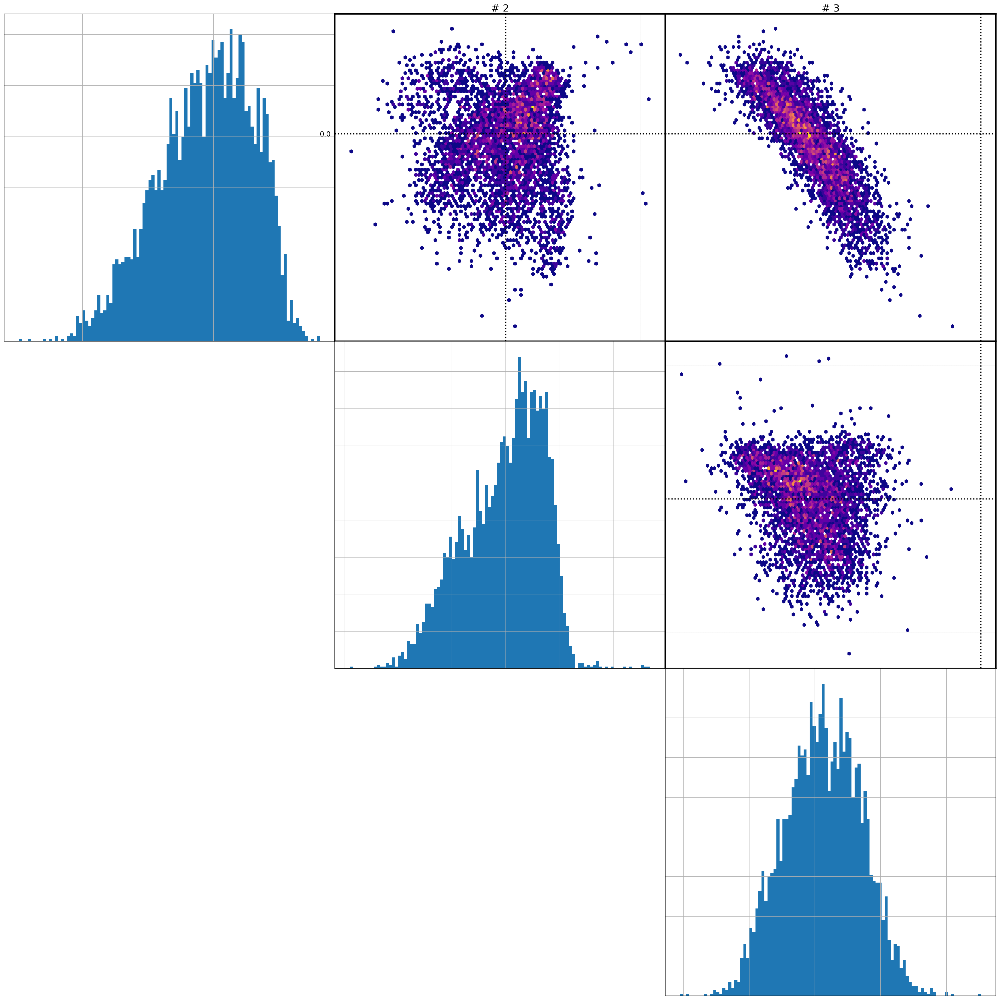

In [47]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [116]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

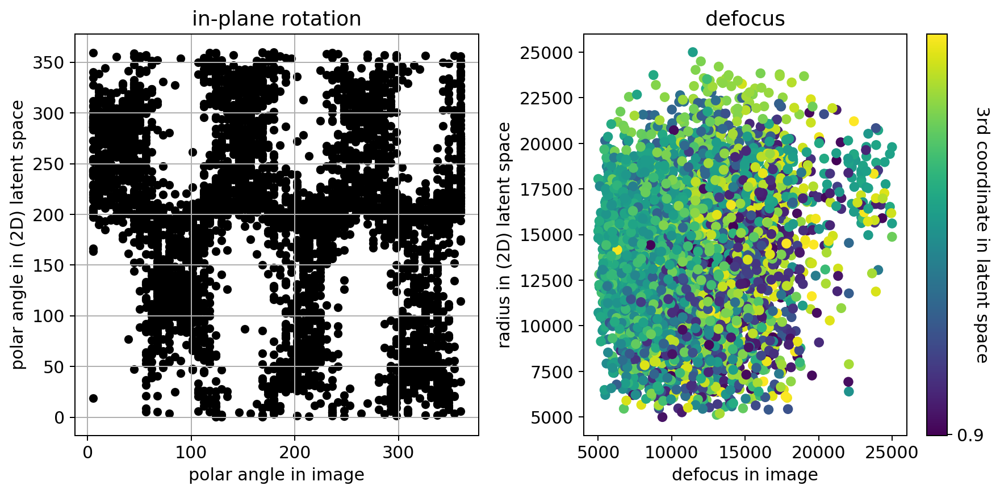

In [117]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

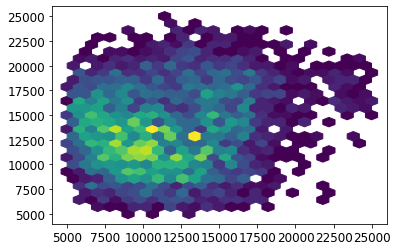

In [118]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: 140 angle RMSE = 106.08448237636058
offset: 141 angle RMSE = 106.01187601459401
offset: 142 angle RMSE = 105.93314807091166
offset: 143 angle RMSE = 105.84775357208419
offset: 144 angle RMSE = 105.7593499921181
offset: 145 angle RMSE = 105.6679184734177
offset: 146 angle RMSE = 105.5728255695579
offset: 147 angle RMSE = 105.47707460911423
offset: 148 angle RMSE = 105.38447755496061
offset: 149 angle RMSE = 105.29061037777717
defocus RMSE = 5481.0003624715955


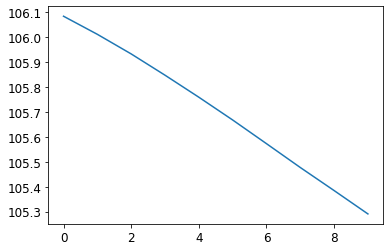

In [119]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(140,150,1))
plt.plot(angle_RMSE_list)